In [4]:
import json
import pandas as pd
import seaborn as sns
import glob, os
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

# Examples

In [4]:
path = "/mnt/win_share/MLW/zettel"

files = list()

for file in os.listdir(path):
    if file.endswith(".jpg"):
        files.append(Image.open(os.path.join(path, file), mode="r"))

KeyboardInterrupt: 

In [3]:
sample = np.random.choice(list(range(len(files))), 20)
sample

array([ 78,  45, 426, 124, 110, 391, 125, 320, 355, 449,  99, 207, 172,
       212, 388,  65, 212, 505,  23, 362])

In [20]:
# from easyimages import EasyImage, EasyImageList, bbox
# Li = EasyImageList.from_folder(path)
# Li.symlink_images()
# Li.html(sample=30, size=44)

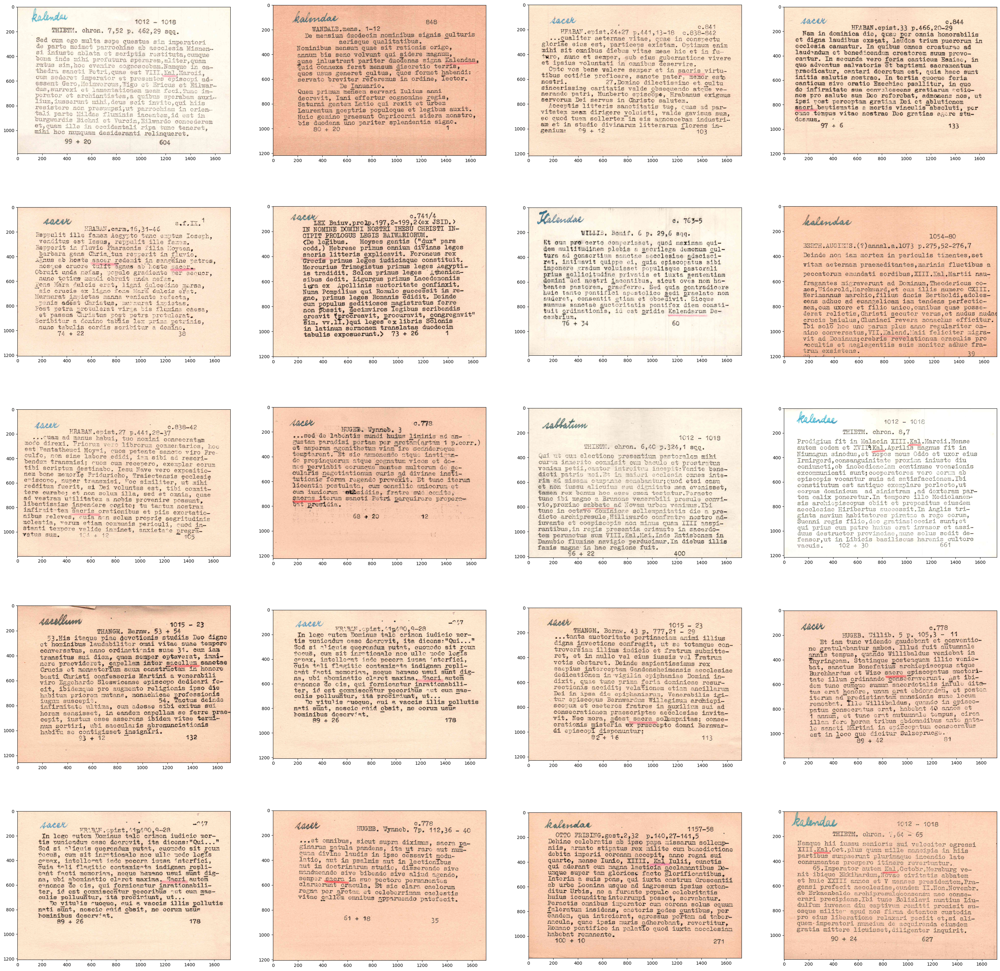

In [5]:
w = 10
h = 10
fig = plt.figure(figsize=(40, 40))
columns = 4
rows = 5
for index, i in enumerate(sample):
    img = np.random.randint(10, size=(h,w))
    fig.add_subplot(rows, columns, index + 1)
    plt.imshow(files[i])
plt.show()

# Analysis of the Lemmata

In [5]:
path = "Z:/MLW/data.json"
f = open(path)
data = json.load(f)
data = pd.DataFrame(data)
print(data)

            id     lemma
0          952    kaheio
1          953       kai
2          954     kakos
3          955  kalendae
4          956  kalendae
...        ...       ...
114648  308587    nimium
114649  308588    nimium
114650  308589    nimium
114651  308590    nimium
114652  308591    nimium

[114653 rows x 2 columns]


In [34]:
data[data["id"]==18607]

,id,lemma,first_letter
4981,18607,satio,s


In [6]:
first_letter = [letter[0] for letter in data.lemma]
data["first_letter"] = first_letter
print(data)

            id     lemma first_letter
0          952    kaheio            k
1          953       kai            k
2          954     kakos            k
3          955  kalendae            k
4          956  kalendae            k
...        ...       ...          ...
114648  308587    nimium            n
114649  308588    nimium            n
114650  308589    nimium            n
114651  308590    nimium            n
114652  308591    nimium            n

[114653 rows x 3 columns]


In [60]:
my_tab = pd.crosstab(index = data["lemma"], columns= "counts", dropna=False)
frequency_data = pd.DataFrame(my_tab)
frequency_data[frequency_data["counts"]<10].count()

col_0
counts    2370
dtype: int64

In [69]:
frequency_data[frequency_data["counts"]>100].count()

col_0
lemma     233
counts    233
groups    233
dtype: int64

In [35]:
frequency_data.shape

(3507, 3)

In [66]:
conditions = [(frequency_data["counts"]<=10),(frequency_data["counts"]>10)&(frequency_data["counts"]<=100),(frequency_data["counts"]>100)]
results = ["group_1","group_2","group_3"]
frequency_data["groups"] = np.select(conditions,results)
frequency_data.reset_index(inplace=True)
frequency_data

col_0,lemma,counts,groups
0,-met,440,group_3
1,-ne,22,group_2
2,-te,3,group_1
3,-tenus,23,group_2
4,-ve,75,group_2
...,...,...,...
3502,zodiacus,2,group_1
3503,zoe,1,group_1
3504,zona,2,group_1
3505,zougenzuht,1,group_1


#### We can see that we have 3057 lemmas in total, from this 2420 (69%) have between 1 or 10 Zettel to train. Additionally, we see also that 1123 (36.7% approx) have just one Zettel.
#### Furthermore, there are 5 particular lemmas beginning with the character "-" that corresponds to 563 Zettels. (Should we try to add these to our training data? Since they wouldn't be represented otherwise

In [24]:
pd.crosstab(index = frequency_data["groups"], columns= "counts", dropna=False)
frequency_data[frequency_data["counts"]==1].count()

col_0
lemma     1123
counts    1123
groups    1123
dtype: int64

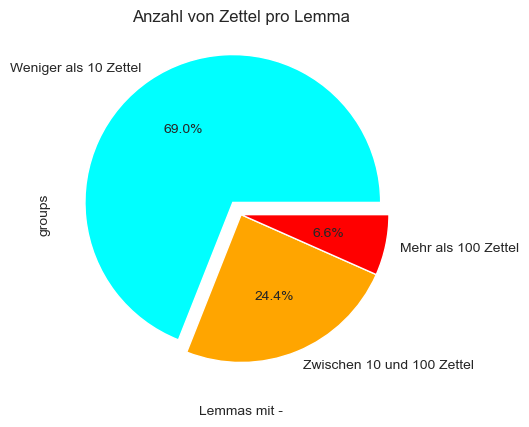

In [68]:
labels=["Weniger als 10 Zettel","Zwischen 10 und 100 Zettel", "Mehr als 100 Zettel"]
pie = frequency_data["groups"].value_counts().plot(kind='pie',labels=labels,autopct = '%1.1f%%', colors= ["cyan","orange","red"], explode = [0.1,0,0])
pie.set_xlabel("Lemmas mit -")
pie.set_title("Anzahl von Zettel pro Lemma")
plt.savefig("C:/Users/Gilar/OneDrive/Escritorio/Consulting-Project/graphics/pie.jpg")

In [47]:
frequency_data[frequency_data["counts"]==10].count()/len(frequency_data)

col_0
lemma     0.014257
counts    0.014257
groups    0.014257
dtype: float64

In [48]:
np.sort(frequency_data["counts"].unique())[-10:]

array([ 985, 1208, 1309, 1428, 1634, 1815, 2232, 2747, 3410, 4206],
      dtype=int64)

# Checking number of cases with a "-"

In [49]:
suffixes = data[data["first_letter"]=="-"]
suffixes.reset_index(drop=True, inplace=True)
my_tab = pd.crosstab(index = suffixes["lemma"], columns= "counts", dropna=False)
print(my_tab)
print("Total of suffixes:"+ str(suffixes.lemma.nunique()))

col_0   counts
lemma         
-met       440
-ne         22
-te          3
-tenus      23
-ve         75
Total of suffixes:5


Text(0.5, 1.0, 'Frequency of Lemmas with -')

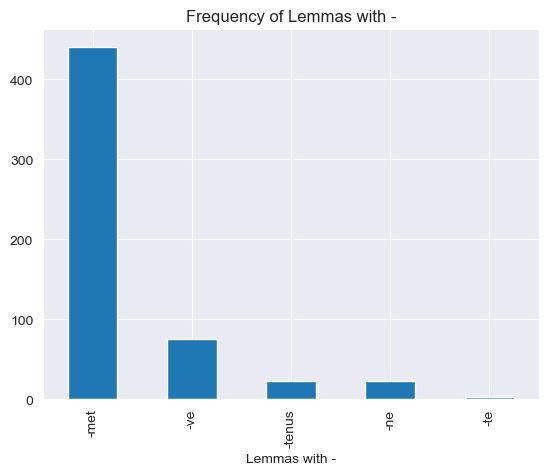

In [57]:
freq = suffixes["lemma"].value_counts().plot(kind='bar')
freq.set_xlabel("Lemmas with -")
freq.set_title("Frequency of Lemmas with -")
#plt.savefig("C:/Users/Gilar/OneDrive/Escritorio/Consulting-Project/graphics/freg-suffixes.jpg")

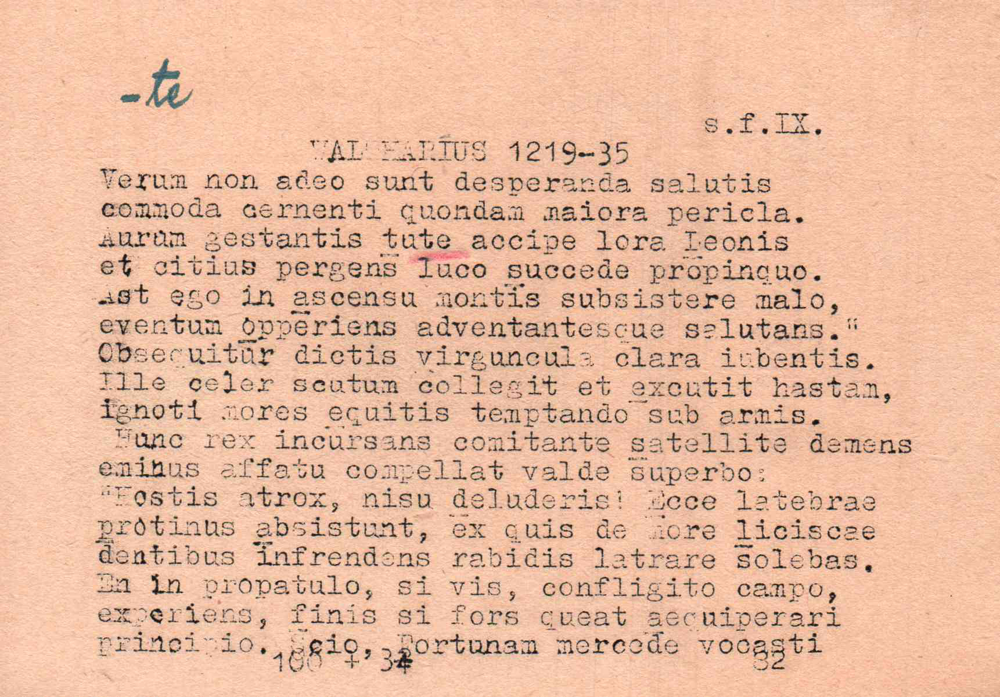

In [30]:
suffixes_id = suffixes["id"].astype("str").to_list()
path_images= "Z:/MLW/zettel/"
file = []
file= [Image.open(os.path.join(path_images, i+".jpg"), mode="r") for i in suffixes_id]
file[0]

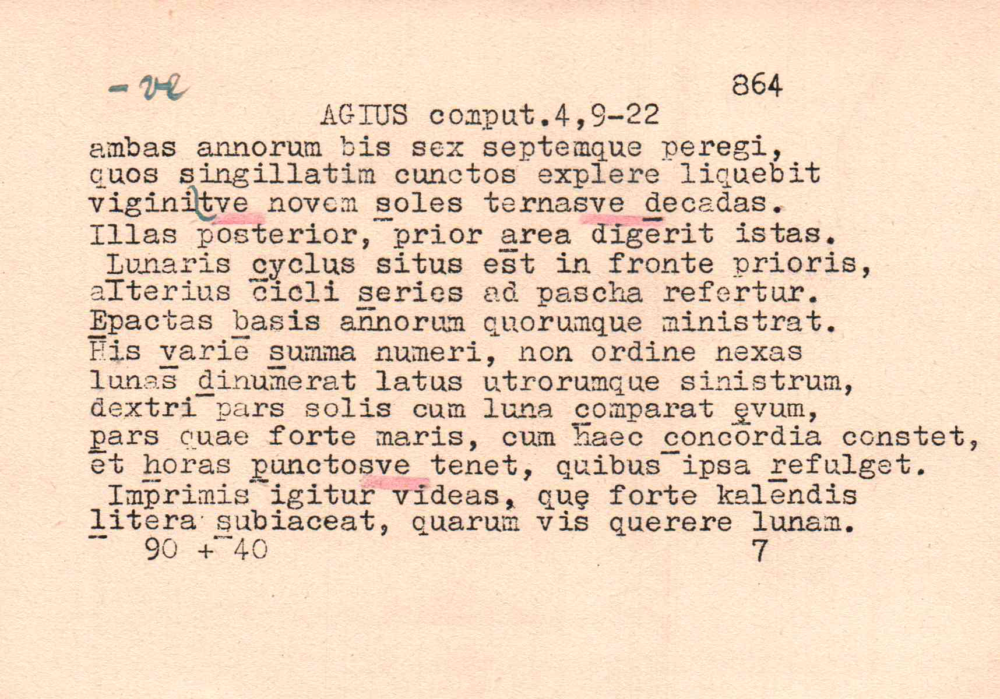

In [51]:
file[4]

In [52]:
my_tab = pd.crosstab(index = data["first_letter"], columns= "counts", dropna=False)
print(my_tab)

col_0         counts
first_letter        
-                563
L                 38
M                 91
S                 54
T                 38
U                  3
V                 10
W                  5
Z                  3
a                  1
e                 36
i                 46
k                195
l               7688
m              18648
n               6584
p                167
q                  6
s              39275
t              14462
u               8753
v              17858
w                 48
x                 10
y                  2
z                 69


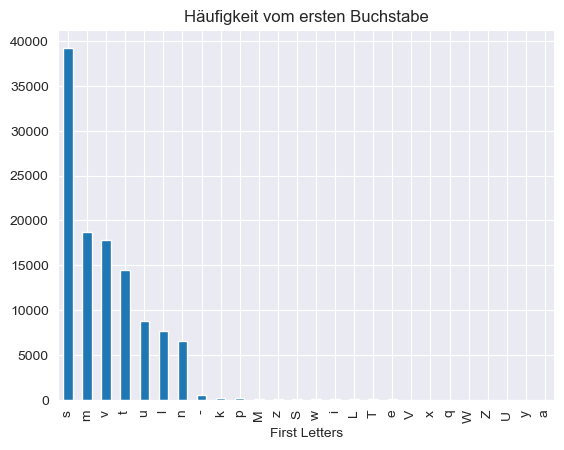

In [124]:
freq = data["first_letter"].value_counts().plot(kind='bar')
freq.set_xlabel("First Letters")
freq.set_title("Häufigkeit vom ersten Buchstabe")
plt.savefig("C:/Users/Gilar/OneDrive/Escritorio/Consulting-Project/graphics/freg-first-letter.jpg")

In [77]:
data_prov["length"] = [len(i) for i in data["lemma"]]

Text(0.5, 1.0, 'Lemmatas Länge')

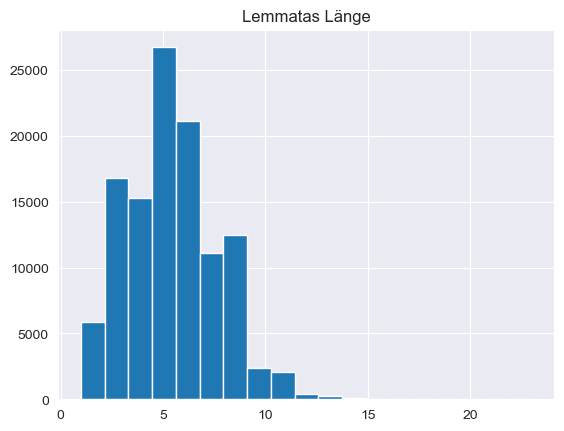

In [139]:
data_prov.length.hist(bins=19)
plt.title("Lemmatas Länge")
#plt.savefig("C:/Users/Gilar/OneDrive/Escritorio/Consulting-Project/graphics/laenge-lemma.jpg")

<AxesSubplot:>

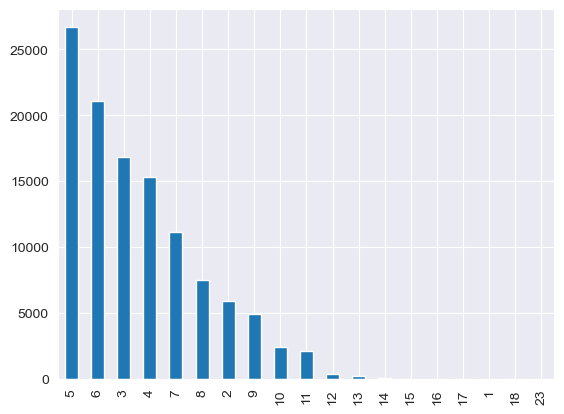

In [82]:
data_prov["length"].value_counts().plot(kind='bar')

In [128]:
data_prov["first_letter"].value_counts()

s    39275
m    18648
v    17858
t    14462
u     8753
l     7688
n     6584
-      563
k      195
p      167
M       91
z       69
S       54
w       48
i       46
L       38
T       38
e       36
V       10
x       10
q        6
W        5
Z        3
U        3
y        2
a        1
Name: first_letter, dtype: int64

In [86]:
data_prov["length"].describe()

count    114653.000000
mean          5.430577
std           2.102692
min           1.000000
25%           4.000000
50%           5.000000
75%           7.000000
max          23.000000
Name: length, dtype: float64

In [130]:
data_prov[data_prov["first_letter"]=="w"]

,id,lemma,first_letter,length
75278,227558,walaraupa,w,9
75279,227559,walaworf,w,8
75280,227560,wancluga,w,8
75281,227561,wancstodal,w,10
75282,227562,wancstodal,w,10
75283,227563,wartivus,w,8
75284,227564,wartivus,w,8
75285,227565,wasilus,w,7
75286,227566,wasilus,w,7
75287,227567,wegalaugen,w,10


In [141]:
data_prov[data_prov["length"]==2].lemma.nunique()

7